<a href="https://colab.research.google.com/github/stwind/gan-experiments/blob/master/stylegan2_ada_ukiyoe_faces.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Setup

In [34]:
#@title Install Dependencies
!pip install -Uq torchinfo ninja

In [2]:
#@title Setup
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import io
import os
import re
import sys
import json
import math
import time
import random
import requests
import pickle
import numpy as np
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import PIL
import cv2
import IPython.display
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.datasets as dset
import torchvision.transforms as tfms
import torchvision.models as models
import umap
from torch.utils.data import DataLoader
from torchvision.utils import make_grid
from torchinfo import summary
from fastprogress.fastprogress import progress_bar

## matplotlib style
sns.set('notebook', 'darkgrid', rc={
    'font.family': ['DejaVu Sans'],
    'font.sans-serif': ['Open Sans', 'Arial Unicode MS'],
    'font.size': 12,
    'figure.figsize': (8, 5),
    'grid.linewidth': 1,
    'grid.alpha': 0.5,
    'legend.fontsize': 10,
    'legend.frameon': True,
    'legend.framealpha': 0.6,
    'legend.handletextpad': 0.2,
    'lines.linewidth': 1,
    'axes.facecolor': '#fafafa',
    'axes.labelsize': 11,
    'axes.titlesize': 12,
    'axes.linewidth': 0.5,
    'xtick.labelsize': 11,
    'xtick.major.width': 0.5,
    'ytick.labelsize': 11,
    'ytick.major.width': 0.5,
    'figure.titlesize': 13,
})
plt.style.use("dark_background")

print("Runtime Infos:")
print("numpy: {}".format(np.__version__))
print("seaborn: {}".format(sns.__version__))
print("matplotlib: {}".format(mpl.__version__))
print("pytorch: {}".format(torch.__version__))
print("umap: {}".format(umap.__version__))
for i in range(torch.cuda.device_count()):
    print("cuda device #{}: {}".format(i, torch.cuda.get_device_name(i)))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("current device type: {}".format(device.type))

!cat /usr/local/cuda/version.txt

from google.colab import drive
drive.mount('/content/gdrive')

Runtime Infos:
numpy: 1.19.5
seaborn: 0.11.1
matplotlib: 3.2.2
pytorch: 1.7.1+cu101
umap: 0.5.1
cuda device #0: Tesla T4
current device type: cuda
CUDA Version 11.0.228
Mounted at /content/gdrive


In [3]:
#@title Utilities

def to_single_rgb(img):
    img = np.asarray(img)
    if len(img.shape) == 4: # take first frame from animations
        return img[0,:,:,:]
    if len(img.shape) == 2: # convert gray to rgb
        return img[:,:,np.newaxis].repeat(3, 2)
    if img.shape[-1] == 4: # drop alpha
        return img[:,:,:3]
    else:
        return img

def imread(url, size=None, mode=None):
    if url.startswith(('http:', 'https:')):
        f = io.BytesIO(requests.get(url).content)
    else:
        f = url
    img = PIL.Image.open(f)
    if size is not None:
        img.thumbnail((size, size), PIL.Image.ANTIALIAS)
    if mode is not None:
        img = img.convert(mode)
    return img

def pil2np(x):
    return np.asarray(x, np.float32) / 255.0

def imshow(img, fmt='png', retina=True, zoom=None):
    if isinstance(img, str):
        IPython.display.display(IPython.display.Image(filename=img, retina=retina))
        return
    
    if len(img.shape) == 1:
        n = len(img)
        side = int(np.sqrt(n))
        if (side * side) != n:
            raise ValueError('input is one-dimensional', img.shape)
        img = img.reshape(side, side)
    if len(img.shape) == 3 and img.shape[-1] == 1:
        img = img.squeeze()
    if img.dtype == np.float32:
        img = img * 255.0
    img = np.uint8(img.clip(0, 255))
    if fmt in ('jpeg', 'jpg'):
        img = to_single_rgb(img)

    data = io.BytesIO()
    PIL.Image.fromarray(img).save(data, fmt)
    height, width = img.shape[:2]
    if zoom is not None:
        width *= zoom
        height *= zoom
    IPython.display.display(IPython.display.Image(data=data.getvalue(),width=width,height=height, retina=retina))

def plt_imshow(img, figsize=(5,5), title=None, cmap=None):
    plt.figure(figsize=figsize)
    plt.imshow(img, cmap)
    if title is not None:
        plt.title(title)
    plt.axis('off')
    plt.show()
    
def minmax(x, axis=None):
    mx = x.max(axis=axis, keepdims=True)
    mn = x.min(axis=axis, keepdims=True)
    return (x - mn) / (mx - mn)

def find_rectangle(n): 
    max_side = int(math.sqrt(n))
    for h in range(2, max_side+1)[::-1]:
        w = n // h
        if (h * w) == n:
            return (h, w)
    return (n, 1)

def make_mosaic(x, nx=None, ny=None):
    n, h, w = x.shape[:3]
    has_channels = len(x.shape) > 3
    if has_channels:
        c = x.shape[3]
        
    if nx is None and ny is None:
        ny,nx = find_rectangle(n)
    elif ny is None:
        ny = n//nx
    elif nx is None:
        nx = n//ny
        
    end_shape = (w,c) if has_channels else (w,)
    mosaic = x.reshape(ny, nx, h, *end_shape)
    mosaic = mosaic.swapaxes(1, 2)
    hh = mosaic.shape[0] * mosaic.shape[1]
    ww = mosaic.shape[2] * mosaic.shape[3]
    end_shape = (ww,c) if has_channels else (ww,)
    return mosaic.reshape(hh, *end_shape)

def resize_images(from_dir, to_dir, size):
    os.makedirs(to_dir, exist_ok=True)
    for p in progress_bar(os.listdir(from_dir)):
        im = imread(os.path.join(from_dir, p)).resize((size, size))
        im.save(os.path.join(to_dir, p))

In [4]:
!if cd stylegan2-ada-pytorch; then git pull; else git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git; fi

if "/content/stylegan2-ada-pytorch" not in sys.path:
    sys.path.append('/content/stylegan2-ada-pytorch')

/bin/bash: line 0: cd: stylegan2-ada-pytorch: No such file or directory
Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating objects: 120, done.
remote: Total 120 (delta 0), reused 0 (delta 0), pack-reused 120
Receiving objects: 100% (120/120), 1.12 MiB | 27.99 MiB/s, done.
Resolving deltas: 100% (53/53), done.


## Data

In [5]:
!gdown --id 1zEgVLrKVp8oCZuX0NENcAeh-kdaKJzNG
%time dset.utils.extract_archive("ukiyoe-1024-v2.tar")

Downloading...
From: https://drive.google.com/uc?id=1zEgVLrKVp8oCZuX0NENcAeh-kdaKJzNG
To: /content/ukiyoe-1024-v2.tar
1.23GB [00:14, 83.9MB/s]
CPU times: user 1.74 s, sys: 820 ms, total: 2.56 s
Wall time: 29.5 s


In [6]:
!python stylegan2-ada-pytorch/dataset_tool.py --source ukiyoe-1024 --dest ukiyoe-256 --width 256 --height 256

100% 5209/5209 [03:03<00:00, 28.36it/s]


## Training

In [7]:
import dnnlib
from train import setup_training_loop_kwargs
from training import training_loop
from torch_utils import misc

In [8]:
outdir = "/content/gdrive/My Drive/ukiyoe"

run_desc, args = setup_training_loop_kwargs(data="ukiyoe-256", metrics=[],
                                            resume="ffhq256", kimg=100, workers=8)

prev_run_dirs = []
if os.path.isdir(outdir):
    prev_run_dirs = [x for x in os.listdir(outdir) if os.path.isdir(os.path.join(outdir, x))]
prev_run_ids = [re.match(r'^\d+', x) for x in prev_run_dirs]
prev_run_ids = [int(x.group()) for x in prev_run_ids if x is not None]
cur_run_id = max(prev_run_ids, default=-1) + 1
args.run_dir = os.path.join(outdir, f'{cur_run_id:05d}-{run_desc}')

In [9]:
assert not os.path.exists(args.run_dir)
os.makedirs(args.run_dir)
with open(os.path.join(args.run_dir, 'training_options.json'), 'wt') as f:
    json.dump(args, f, indent=2)

In [10]:
args

{'D_kwargs': {'block_kwargs': {},
  'channel_base': 16384,
  'channel_max': 512,
  'class_name': 'training.networks.Discriminator',
  'conv_clamp': 256,
  'epilogue_kwargs': {'mbstd_group_size': 4},
  'mapping_kwargs': {},
  'num_fp16_res': 4},
 'D_opt_kwargs': {'betas': [0, 0.99],
  'class_name': 'torch.optim.Adam',
  'eps': 1e-08,
  'lr': 0.0025},
 'G_kwargs': {'class_name': 'training.networks.Generator',
  'mapping_kwargs': {'num_layers': 2},
  'synthesis_kwargs': {'channel_base': 16384,
   'channel_max': 512,
   'conv_clamp': 256,
   'num_fp16_res': 4},
  'w_dim': 512,
  'z_dim': 512},
 'G_opt_kwargs': {'betas': [0, 0.99],
  'class_name': 'torch.optim.Adam',
  'eps': 1e-08,
  'lr': 0.0025},
 'ada_kimg': 100,
 'ada_target': 0.6,
 'augment_kwargs': {'aniso': 1,
  'brightness': 1,
  'class_name': 'training.augment.AugmentPipe',
  'contrast': 1,
  'hue': 1,
  'lumaflip': 1,
  'rotate': 1,
  'rotate90': 1,
  'saturation': 1,
  'scale': 1,
  'xflip': 1,
  'xfrac': 1,
  'xint': 1},
 'batc

In [11]:
def progress_fn(cur, total):
    print("progress", cur, total)

training_loop.training_loop(rank=0, **args)

Loading training set...

Num images:  5209
Image shape: [3, 256, 256]
Label shape: [0]

Constructing networks...
Resuming from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/transfer-learning-source-nets/ffhq-res256-mirror-paper256-noaug.pkl"
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.

Generator             Parameters  Buffers  Output shape         Datatype
---                   ---         ---      ---                  ---     
mapping.fc0           262656      -        [16, 512]            float32 
mapping.fc1           262656      -        [16, 512]            float32 
mapping               -           512      [16, 14, 512]        float32 
synthesis.b4.conv1    2622465     32       [16, 512, 4, 4]      float32 
synthesis.b4.torgb    264195      -        [16, 3, 4, 4]        float32 
synthesis.b4:0        8192        16       [16, 512, 4, 4]      float32 
synthesis.b4:1        -           -        [1

## Results

In [13]:
with open(os.path.join(args.run_dir, "network-snapshot-000100.pkl"), 'rb') as f:
    G = pickle.load(f)['G_ema'].to(device)

In [31]:
def slerp(p0, p1, t):
    omega = np.arccos(np.dot(p0 / np.linalg.norm(p0), p1 / np.linalg.norm(p1)))
    so = np.sin(omega)
    return np.sin((1.0 - t) * omega) / so * p0 + np.sin(t * omega) / so * p1


def make_analogy_grid(anchors):
    n, dim = len(anchors), anchors.shape[1]
    rows = n // 2 + 1
    cols = n - rows + 1
    grid = np.zeros((rows, cols, dim), dtype=np.float32)
    for y in range(rows):
        for x in range(cols):
            if x == 0 or y == 0:
                if x == 0 and y == 0:
                    idx = 0
                elif x == 0:
                    idx = y * 2 - 1
                else:
                    idx = x * 2
                grid[y, x, :] = anchors[idx]
            else:
                anal_vec = grid[y, x - 1, :] + grid[y - 1, x, :] - grid[y - 1, x - 1, :]
                anal_unit_vec = np.nan_to_num(anal_vec / np.linalg.norm(anal_vec))
                avg_len = (
                    np.linalg.norm(grid[y, x - 1, :])
                    + np.linalg.norm(grid[y - 1, x, :])
                    + np.linalg.norm(grid[y - 1, x - 1, :])
                ) / 3.0
                grid[y, x, :] = avg_len * anal_unit_vec
    return grid.reshape(-1, dim)


def make_mine_grid(anchors, nrow, space):
    dim = anchors.shape[1]
    ncol = len(anchors) // nrow
    rows = (nrow - 1) * space + 1
    cols = (ncol - 1) * space + 1

    grid = np.zeros((rows, cols, dim), dtype=np.float32)

    for y in range(rows):
        for x in range(cols):
            if y % space == 0 and x % space == 0:
                idx = (y // space) * ncol + (x // space)
                grid[y, x, :] = anchors[idx]

    for y in range(rows):
        for x in range(cols):
            if y % space == 0 and x % space != 0:
                prev = space * (x // space)
                cur = prev + space
                t = (x - prev) / space
                grid[y, x, :] = slerp(grid[y, prev, :], grid[y, cur, :], t)

    for y in range(rows):
        for x in range(cols):
            if y % space != 0:
                prev = space * (y // space)
                cur = prev + space
                t = (y - prev) / space
                grid[y, x, :] = slerp(grid[prev, x, :], grid[cur, x, :], t)

    return grid.reshape(-1, dim)

def denormalize(img):
    return (img * 0.5 + 0.5).clamp(0, 1)

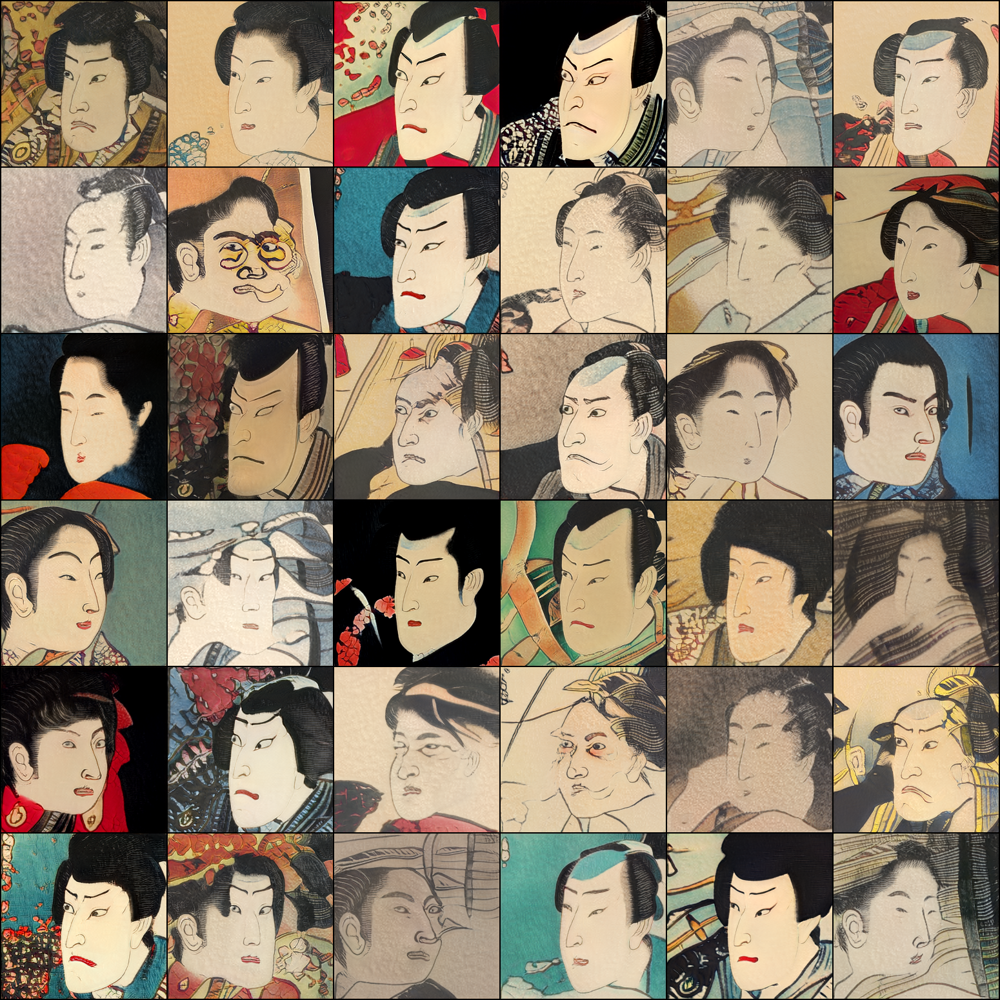

In [49]:
z = torch.randn((36, G.z_dim)).to(device)
img = G(z, None).cpu()

imshow(make_grid(denormalize(img),nrow=6).permute(1,2,0).numpy())

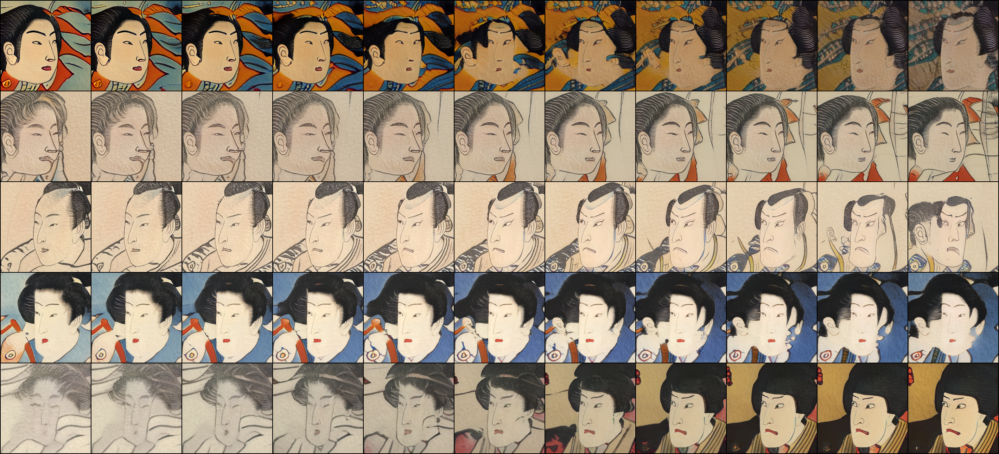

In [48]:
z = []
for _ in range(5):
    z1, z2 = torch.randn(2, G.z_dim)
    t = torch.linspace(0,1,11).view(-1,1)
    z.append(slerp(z1, z2, t))

z = torch.vstack(z).to(device)
img = G(z, None).cpu()
imshow(make_grid(denormalize(img),nrow=11).permute(1,2,0).numpy())

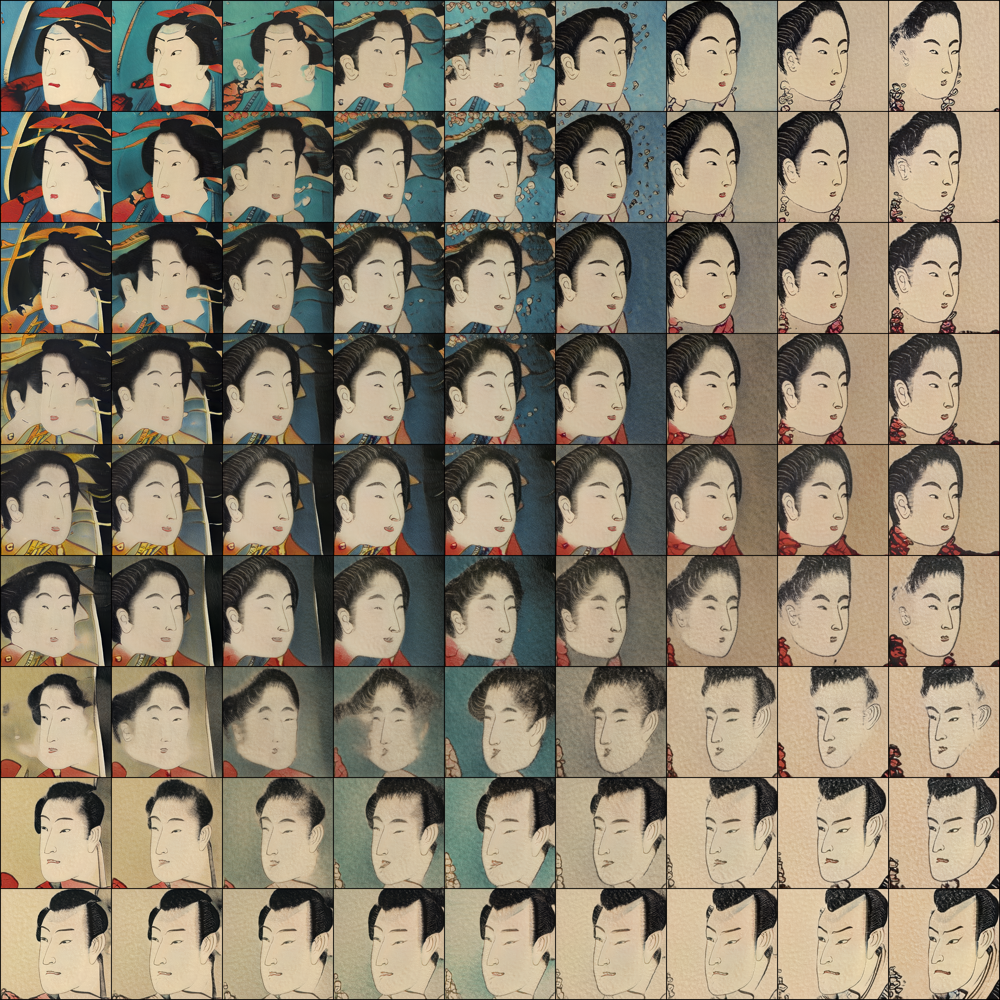

In [56]:
z = make_mine_grid(make_analogy_grid(np.random.randn(5, G.z_dim)), nrow=3, space=4)
z = torch.from_numpy(z).to(device)
img = G(z, None).cpu()

imshow(make_grid(denormalize(img),nrow=9).permute(1,2,0).numpy())